In [ ]:
from PIL import Image, ImageOps
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import image
import glob, os
import math
from scipy import spatial
import random

In [ ]:
def load_image(source : str) -> np.ndarray:
    ''' Opens an image from specified source and returns a numpy array with image rgb data
    '''
    with Image.open(source,'r') as im:
        im_arr = np.asarray(im)
    return im_arr

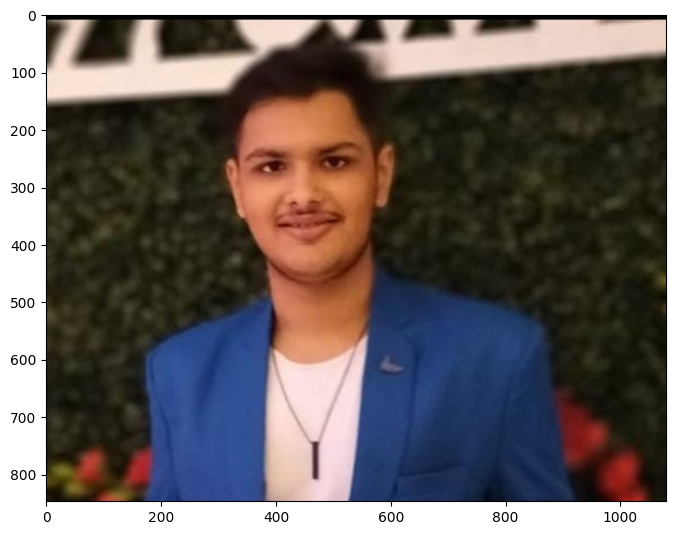

In [ ]:
plt.figure(figsize=(8,8))
face_im_arr = load_image('/content/pic my.jpg')
face_image = Image.fromarray(face_im_arr)
plt.imshow(face_image)
plt.show()

In [ ]:
width = face_im_arr.shape[0]
height = face_im_arr.shape[1]

In [ ]:
target_res = (100, 100)

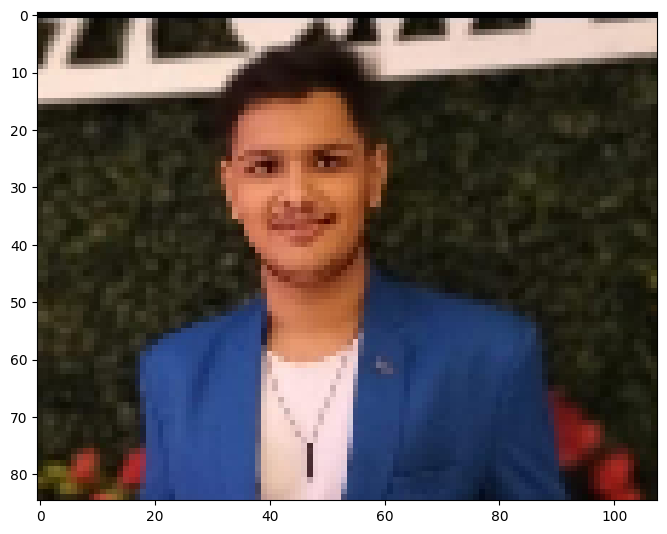

In [ ]:
plt.figure(figsize=(8,8))
mos_template = face_im_arr[::(height//target_res[0]),::(height//target_res[1])]
plt.imshow(Image.fromarray(mos_template))
plt.show()

In [ ]:
mos_template[:,:, -1].size

9180

In [ ]:
!git clone https://github.com/MstrFunkBass/facemo.git

fatal: destination path 'facemo' already exists and is not an empty directory.


In [ ]:
import glob
import numpy as np
from PIL import Image

images = []

for file in glob.glob('/content/facemo/Images/Mosaic-Images/*'):
    # Open the image file
    im = Image.open(file)

    # Convert to numpy array and append
    images.append(np.array(im))

# Filter images based on number of dimensions (if needed)
images = [i for i in images if i.ndim == 3]

In [ ]:
def resize_image(img : Image, size : tuple) -> np.ndarray:
    '''Takes an image and resizes to a given size (width, height) as passed to the size parameter
    '''
    resz_img = ImageOps.fit(img, size, Image.ANTIALIAS, centering=(0.5, 0.5))
    return np.array(resz_img)

In [ ]:
mosaic_size = (40, 40) ## Defines size of each mosiac image
images = [resize_image(Image.fromarray(i), mosaic_size) for i in images]

<ipython-input-85-d2b178d8c838>:4: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  resz_img = ImageOps.fit(img, size, Image.ANTIALIAS, centering=(0.5, 0.5))


In [ ]:
len(images)

1000

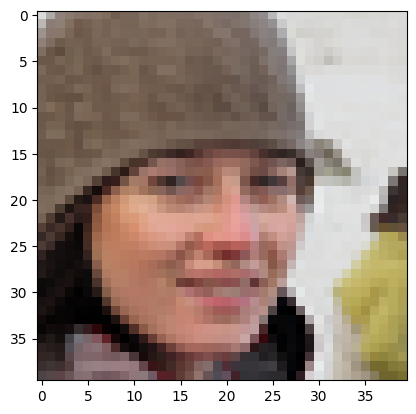

In [ ]:
plt.imshow(Image.fromarray(images[68]))
plt.show()

In [ ]:
images_array = np.asarray(images)
images_array.shape

(1000, 40, 40, 3)

In [ ]:
image_values = np.apply_over_axes(np.mean, images_array, [1,2]).reshape(len(images),3)
image_values

array([[153.510625, 116.85875 , 111.99    ],
       [102.595   ,  80.990625,  75.6075  ],
       [108.83375 , 103.08625 ,  83.808125],
       ...,
       [128.730625, 102.69625 ,  91.50875 ],
       [101.559375,  83.01625 ,  75.3475  ],
       [213.734375, 185.94625 , 161.81625 ]])

In [ ]:
tree = spatial.KDTree(image_values)

In [ ]:
image_idx = np.zeros(target_res, dtype=np.uint32)

for i in range(target_res[0]):
    for j in range(target_res[1]):

        # Ensure you are within the valid index range for mos_template
        if i < mos_template.shape[0] and j < mos_template.shape[1]:
            template = mos_template[i, j]

            match = tree.query(template, k=40)
            pick = random.randint(0, 39)
            image_idx[i, j] = match[1][pick]
        else:
            print(f"Warning: Skipping index ({i}, {j}) as it is out of bounds for mos_template.")

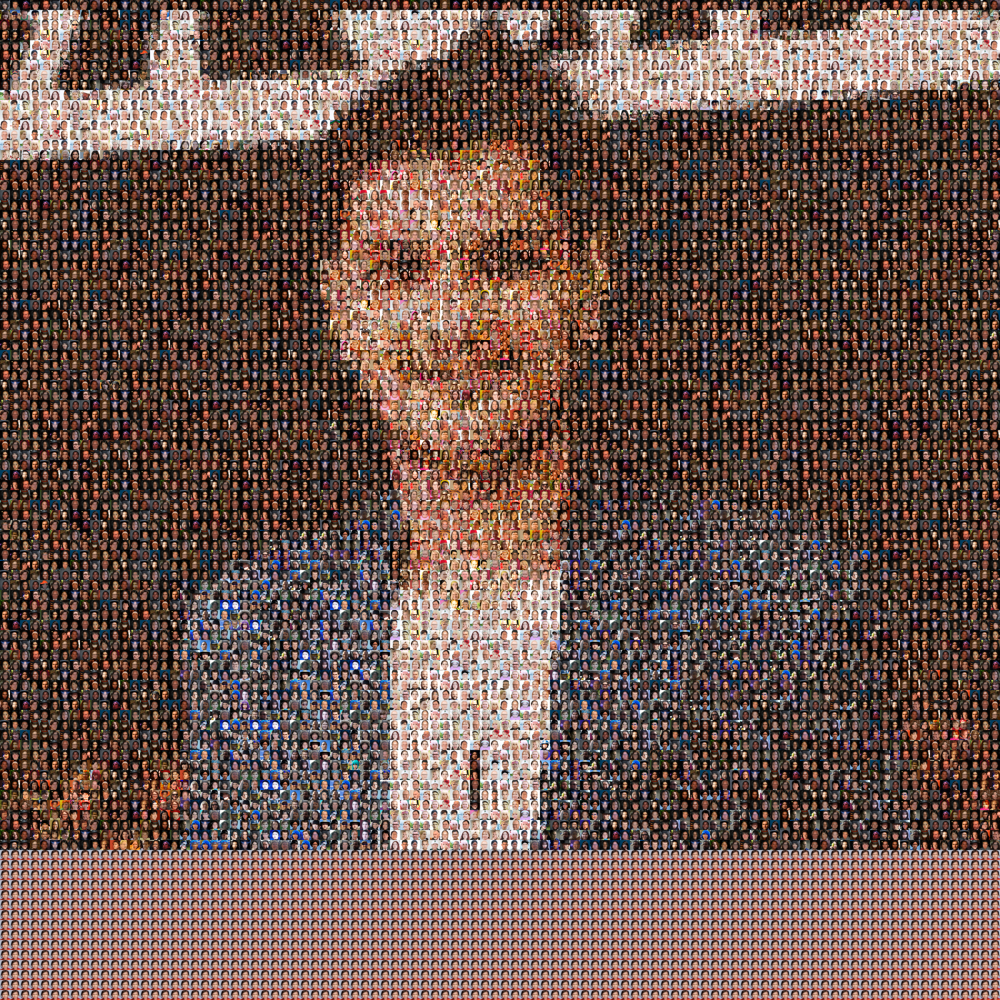

In [ ]:
canvas = Image.new('RGB', (mosaic_size[0]*target_res[0], mosaic_size[1]*target_res[1]))

for i in range(target_res[0]):
    for j in range(target_res[1]):
        arr = images[image_idx[j, i]]
        x, y = i*mosaic_size[0], j*mosaic_size[1]
        im = Image.fromarray(arr)
        canvas.paste(im, (x,y))

canvas